In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

MainModule = pd.read_csv('googleplaystore.csv', index_col="App")

In [2]:
MainModule.head() # get First Records 

,Category,Rating,Reviews,Size,Installs,Type,Price,Content Rating,Genres,Last Updated,Current Ver,Android Ver
App,,,,,,,,,,,,
Photo Editor & Candy Camera & Grid & ScrapBook,ART_AND_DESIGN,4.1,159,19M,"10,000+",Free,0,Everyone,Art & Design,"January 7, 2018",1.0.0,4.0.3 and up
Coloring book moana,ART_AND_DESIGN,3.9,967,14M,"500,000+",Free,0,Everyone,Art & Design;Pretend Play,"January 15, 2018",2.0.0,4.0.3 and up
"U Launcher Lite – FREE Live Cool Themes, Hide Apps",ART_AND_DESIGN,4.7,87510,8.7M,"5,000,000+",Free,0,Everyone,Art & Design,"August 1, 2018",1.2.4,4.0.3 and up
Sketch - Draw & Paint,ART_AND_DESIGN,4.5,215644,25M,"50,000,000+",Free,0,Teen,Art & Design,"June 8, 2018",Varies with device,4.2 and up
Pixel Draw - Number Art Coloring Book,ART_AND_DESIGN,4.3,967,2.8M,"100,000+",Free,0,Everyone,Art & Design;Creativity,"June 20, 2018",1.1,4.4 and up


In [3]:
MainModule.tail() #get the last records

,Category,Rating,Reviews,Size,Installs,Type,Price,Content Rating,Genres,Last Updated,Current Ver,Android Ver
App,,,,,,,,,,,,
Sya9a Maroc - FR,FAMILY,4.5,38,53M,"5,000+",Free,0,Everyone,Education,"July 25, 2017",1.48,4.1 and up
Fr. Mike Schmitz Audio Teachings,FAMILY,5.0,4,3.6M,100+,Free,0,Everyone,Education,"July 6, 2018",1.0,4.1 and up
Parkinson Exercices FR,MEDICAL,NaN,3,9.5M,"1,000+",Free,0,Everyone,Medical,"January 20, 2017",1.0,2.2 and up
The SCP Foundation DB fr nn5n,BOOKS_AND_REFERENCE,4.5,114,Varies with device,"1,000+",Free,0,Mature 17+,Books & Reference,"January 19, 2015",Varies with device,Varies with device
iHoroscope - 2018 Daily Horoscope & Astrology,LIFESTYLE,4.5,398307,19M,"10,000,000+",Free,0,Everyone,Lifestyle,"July 25, 2018",Varies with device,Varies with device


In [32]:
MainModule.info() #get Information about data

<class 'pandas.core.frame.DataFrame'>
Index: 10841 entries, Photo Editor & Candy Camera & Grid & ScrapBook to iHoroscope - 2018 Daily Horoscope & Astrology
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Category        10841 non-null  object 
 1   Rating          9367 non-null   float64
 2   Reviews         10841 non-null  object 
 3   Size            10841 non-null  object 
 4   Installs        10841 non-null  object 
 5   Type            10840 non-null  object 
 6   Price           10841 non-null  object 
 7   Content Rating  10840 non-null  object 
 8   Genres          10841 non-null  object 
 9   Last Updated    10841 non-null  object 
dtypes: float64(1), object(9)
memory usage: 931.6+ KB


In [36]:
#Removeing Null values from Dataset
nulls =[i for i in MainModule.isna().any().index if MainModule.isna().any()[i]==True]
rates =[]
counts =[]
for i in nulls:
    rates.append((MainModule[i].isna().sum()/MainModule.shape[0])*100)
    counts.append(MainModule[i].isna().sum())
null_DataFrame = pd.DataFrame.from_dict({"Col":nulls,"Count":counts,"Null_Rates":rates})


In [40]:
# MainModule = MainModule.drop(["Current Ver","Android Ver"],1)

In [37]:
null_DataFrame

,Col,Count,Null_Rates
0,Rating,1474,13.596532
1,Type,1,0.009224
2,Content Rating,1,0.009224


In [ ]:
#Missing Values( Data Cleaning For Null values )

In [38]:
#delete Type,Content Rating, Current Ver, Android Ver null values row
df_train = MainModule.copy()
for i in ['Type','Content Rating']:
    df_train = df_train.drop(df_train.loc[df_train[i].isnull()].index,0)
df_train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 10839 entries, Photo Editor & Candy Camera & Grid & ScrapBook to iHoroscope - 2018 Daily Horoscope & Astrology
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Category        10839 non-null  object 
 1   Rating          9366 non-null   float64
 2   Reviews         10839 non-null  object 
 3   Size            10839 non-null  object 
 4   Installs        10839 non-null  object 
 5   Type            10839 non-null  object 
 6   Price           10839 non-null  object 
 7   Content Rating  10839 non-null  object 
 8   Genres          10839 non-null  object 
 9   Last Updated    10839 non-null  object 
dtypes: float64(1), object(9)
memory usage: 931.5+ KB


In [19]:
#rating in Percentage 1 to 5
df_train.Rating.describe()

count    9366.000000
mean        4.191757
std         0.515219
min         1.000000
25%         4.000000
50%         4.300000
75%         4.500000
max         5.000000
Name: Rating, dtype: float64

In [20]:
#Rating should not to be up to 5
df_train =df_train[df_train["Rating"]<=5]

In [ ]:
#1. Category
#machine learning, we are converting objects to numbers.

In [21]:
#get unique values in Catagory feature 
df_train.Category.unique()

array(['ART_AND_DESIGN', 'AUTO_AND_VEHICLES', 'BEAUTY',
       'BOOKS_AND_REFERENCE', 'BUSINESS', 'COMICS', 'COMMUNICATION',
       'DATING', 'EDUCATION', 'ENTERTAINMENT', 'EVENTS', 'FINANCE',
       'FOOD_AND_DRINK', 'HEALTH_AND_FITNESS', 'HOUSE_AND_HOME',
       'LIBRARIES_AND_DEMO', 'LIFESTYLE', 'GAME', 'FAMILY', 'MEDICAL',
       'SOCIAL', 'SHOPPING', 'PHOTOGRAPHY', 'SPORTS', 'TRAVEL_AND_LOCAL',
       'TOOLS', 'PERSONALIZATION', 'PRODUCTIVITY', 'PARENTING', 'WEATHER',
       'VIDEO_PLAYERS', 'NEWS_AND_MAGAZINES', 'MAPS_AND_NAVIGATION'],
      dtype=object)

In [23]:
# convert to categorical Categority by using one hot tecnique 
df_dummy  = df_train.copy()
df_train.Category = pd.Categorical
(df_dummy.Category)

x = df_dummy[['Category']]
del df_dummy['Category']

dummies  = pd.get_dummies(x, prefix='Category')
df_dummy = pd.concat([df_dummy,dummies], axis=1)
df_dummy.head()


,Rating,Reviews,Size,Installs,Type,Price,Content Rating,Genres,Last Updated,Category_ART_AND_DESIGN,...,Category_PERSONALIZATION,Category_PHOTOGRAPHY,Category_PRODUCTIVITY,Category_SHOPPING,Category_SOCIAL,Category_SPORTS,Category_TOOLS,Category_TRAVEL_AND_LOCAL,Category_VIDEO_PLAYERS,Category_WEATHER
App,,,,,,,,,,,,,,,,,,,,,
Photo Editor & Candy Camera & Grid & ScrapBook,4.1,159,19M,"10,000+",Free,0,Everyone,Art & Design,"January 7, 2018",1,...,0,0,0,0,0,0,0,0,0,0
Coloring book moana,3.9,967,14M,"500,000+",Free,0,Everyone,Art & Design;Pretend Play,"January 15, 2018",1,...,0,0,0,0,0,0,0,0,0,0
"U Launcher Lite – FREE Live Cool Themes, Hide Apps",4.7,87510,8.7M,"5,000,000+",Free,0,Everyone,Art & Design,"August 1, 2018",1,...,0,0,0,0,0,0,0,0,0,0
Sketch - Draw & Paint,4.5,215644,25M,"50,000,000+",Free,0,Teen,Art & Design,"June 8, 2018",1,...,0,0,0,0,0,0,0,0,0,0
Pixel Draw - Number Art Coloring Book,4.3,967,2.8M,"100,000+",Free,0,Everyone,Art & Design;Creativity,"June 20, 2018",1,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
#2. Genres (Types)

In [24]:
#Genres unique value 
df_dummy["Genres"].unique()

array(['Art & Design', 'Art & Design;Pretend Play',
       'Art & Design;Creativity', 'Auto & Vehicles', 'Beauty',
       'Books & Reference', 'Business', 'Comics', 'Comics;Creativity',
       'Communication', 'Dating', 'Education;Education', 'Education',
       'Education;Creativity', 'Education;Music & Video',
       'Education;Action & Adventure', 'Education;Pretend Play',
       'Education;Brain Games', 'Entertainment',
       'Entertainment;Music & Video', 'Entertainment;Brain Games',
       'Entertainment;Creativity', 'Events', 'Finance', 'Food & Drink',
       'Health & Fitness', 'House & Home', 'Libraries & Demo',
       'Lifestyle', 'Lifestyle;Pretend Play',
       'Adventure;Action & Adventure', 'Arcade', 'Casual', 'Card',
       'Casual;Pretend Play', 'Action', 'Strategy', 'Puzzle', 'Sports',
       'Music', 'Word', 'Racing', 'Casual;Creativity',
       'Casual;Action & Adventure', 'Simulation', 'Adventure', 'Board',
       'Trivia', 'Role Playing', 'Simulation;Education',
 

Text(0.5, 1.0, 'Category And There Counts')

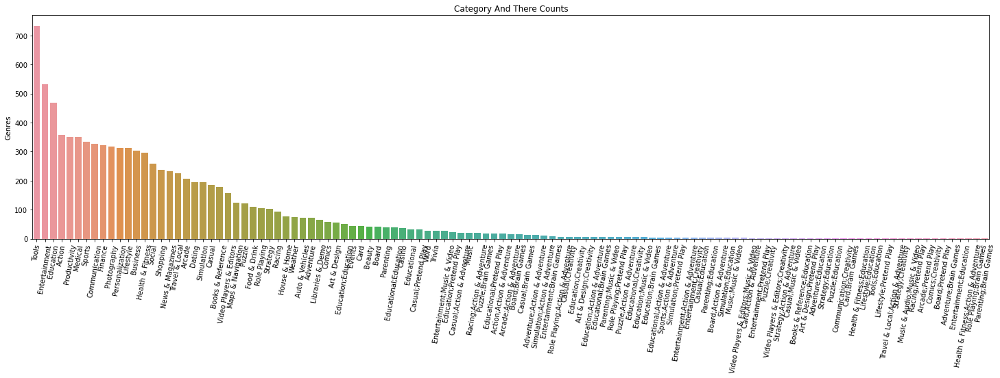

In [27]:
plt.figure(figsize=(25,6))
sns.barplot(x =df_dummy.Genres.value_counts().index, y = df_dummy.Genres.value_counts())
plt.xticks(rotation = 80)
plt.title("Category And There Counts")


In [28]:
np.sort(df_dummy.Genres.value_counts())

array([  1,   1,   1,   1,   1,   1,   1,   1,   1,   1,   1,   1,   1,
         1,   1,   1,   1,   1,   1,   1,   2,   2,   2,   2,   2,   2,
         2,   2,   2,   3,   3,   3,   3,   3,   3,   3,   3,   4,   4,
         4,   4,   5,   5,   5,   5,   6,   6,   6,   7,   7,   7,   7,
         8,  11,  13,  13,  15,  15,  17,  18,  19,  20,  21,  21,  23,
        27,  28,  28,  31,  32,  37,  38,  40,  41,  42,  45,  45,  50,
        56,  57,  65,  73,  73,  75,  76,  93, 103, 106, 109, 121, 124,
       158, 178, 185, 194, 195, 207, 225, 233, 238, 259, 297, 303, 313,
       314, 317, 323, 328, 333, 350, 351, 358, 468, 533, 733], dtype=int64)

In [29]:
#Some haves very Low Upload Counts 
#So Will Classifies those who do not have a significant number of Uploads as others

In [30]:
Low_Uploads  = []

for i in df_dummy.Genres.value_counts().index:
    if df_dummy.Genres.value_counts()[i] < 20:
        Low_Uploads.append(i)

print(len(Low_Uploads),"Low Uploads Count those are Less then 20")
df_dummy.Genres = ['Others' if i in Low_Uploads else i for i in df_dummy.Genres]

61 Low Uploads Count those are Less then 20


In [31]:
df_dummy.shape

(9366, 42)

In [ ]:
#3. Contant Rating

In [46]:
df_dummy["Content Rating"].value_counts(dropna= False)

Everyone           7420
Teen               1084
Mature 17+          461
Everyone 10+        397
Adults only 18+       3
Unrated               1
Name: Content Rating, dtype: int64

In [49]:
Data = df_dummy.copy()
Data['Content Rating'] = Data['Content Rating'].map({'Unreted': 0.0,
"Everyone":1.0,
"Everyone 10+":2.0,
'Teen':3.0,
'Adults only 18+':4.0,
'Mature 17+':5.0})


In [53]:
Data['Content Rating'] = Data["Content Rating"].astype(float)
Data.head()

,Rating,Reviews,Size,Installs,Type,Price,Content Rating,Genres,Last Updated,Category_ART_AND_DESIGN,...,Category_PERSONALIZATION,Category_PHOTOGRAPHY,Category_PRODUCTIVITY,Category_SHOPPING,Category_SOCIAL,Category_SPORTS,Category_TOOLS,Category_TRAVEL_AND_LOCAL,Category_VIDEO_PLAYERS,Category_WEATHER
App,,,,,,,,,,,,,,,,,,,,,
Photo Editor & Candy Camera & Grid & ScrapBook,4.1,159,19M,"10,000+",Free,0,1.0,Art & Design,"January 7, 2018",1,...,0,0,0,0,0,0,0,0,0,0
Coloring book moana,3.9,967,14M,"500,000+",Free,0,1.0,Others,"January 15, 2018",1,...,0,0,0,0,0,0,0,0,0,0
"U Launcher Lite – FREE Live Cool Themes, Hide Apps",4.7,87510,8.7M,"5,000,000+",Free,0,1.0,Art & Design,"August 1, 2018",1,...,0,0,0,0,0,0,0,0,0,0
Sketch - Draw & Paint,4.5,215644,25M,"50,000,000+",Free,0,3.0,Art & Design,"June 8, 2018",1,...,0,0,0,0,0,0,0,0,0,0
Pixel Draw - Number Art Coloring Book,4.3,967,2.8M,"100,000+",Free,0,1.0,Others,"June 20, 2018",1,...,0,0,0,0,0,0,0,0,0,0


In [54]:
#4.Reviews 

In [126]:
#Change Type To Float 
Data_Cpy = Data.copy()
Data_Cpy['Reviews'] = Data_Cpy['Reviews'].astype(float)

In [58]:
#5.Size

In [127]:
Data_Cpy["Size"].value_counts()

Varies with device    1637
14M                    166
12M                    161
11M                    160
15M                    159
                      ... 
976k                     1
608k                     1
39k                      1
730k                     1
619k                     1
Name: Size, Length: 414, dtype: int64

In [128]:
#clean 'M','k', fill 'Varies with device' with median and transform to float 
lists = []
for i in Data_Cpy["Size"]:
    if 'M' in i:
        i = float(i.replace('M',''))
        i = i *1000000
        lists.append(i)
    elif 'k' in i:
        i = float(i.replace('k',''))
        i = i*1000
        lists.append(i)
    else:
        lists.append("Unknown")
k = pd.Series(lists)
median = k[k!="Unknown"].median()
k = [median if i =="Unknown" else i for i in k ]
Data_Cpy["Size"] = k

del k,median,lists

In [129]:
#clean 'M'and transform to float 
print("Old", Data["Size"][10],"New",Data_Cpy["Size"][10])

Old 28M New 28000000.0


In [130]:
Data_Cpy['Price'] = [float(i.split('$')[1]) if '$' in i else float(0) for i in Data_Cpy['Price']]

In [131]:
print("old: ",Data['Price'][9054]," new: ",Data_Cpy['Price'][9054])

old:  0  new:  0.0


In [132]:
Data_Cpy.Price.unique()

array([  0.  ,   4.99,   3.99,   6.99,   7.99,   5.99,   2.99,   3.49,
         1.99,   9.99,   7.49,   0.99,   9.  ,   5.49,  10.  ,  24.99,
        11.99,  79.99,  16.99,  14.99,  29.99,  12.99,   2.49,  10.99,
         1.5 ,  19.99,  15.99,  33.99,  39.99,   3.95,   4.49,   1.7 ,
         8.99,   1.49,   3.88, 399.99,  17.99, 400.  ,   3.02,   1.76,
         4.84,   4.77,   1.61,   2.5 ,   1.59,   6.49,   1.29, 299.99,
       379.99,  37.99,  18.99, 389.99,   8.49,   1.75,  14.  ,   2.  ,
         3.08,   2.59,  19.4 ,   3.9 ,   4.59,  15.46,   3.04,  13.99,
         4.29,   3.28,   4.6 ,   1.  ,   2.95,   2.9 ,   1.97,   2.56,
         1.2 ])

In [133]:
Data_Cpy.Installs.unique()


array(['10,000+', '500,000+', '5,000,000+', '50,000,000+', '100,000+',
       '50,000+', '1,000,000+', '10,000,000+', '5,000+', '100,000,000+',
       '1,000,000,000+', '1,000+', '500,000,000+', '100+', '500+', '10+',
       '5+', '50+', '1+'], dtype=object)

In [134]:
Data_Cpy["Installs"] = [ float(i.replace('+','').replace(',', '')) if '+' in i or ',' in i else float(0) for i in Data_Cpy["Installs"] ]

In [136]:
print("Old Values: ",Data['Installs'][0]," New Values: ",Data_Cpy['Installs'][0])

Old Values:  10,000+  New Values:  10000.0


In [144]:
Data_Cpy.Type.unique()

array(['Free', 'Paid'], dtype=object)

In [146]:
Data_Cpy.Type = Data_Cpy.Type.map({'Free':0,'Paid':1})

In [156]:
Data_Cpy['Last Updated'][:3]

App
Photo Editor & Candy Camera & Grid & ScrapBook         January 7, 2018
Coloring book moana                                   January 15, 2018
U Launcher Lite – FREE Live Cool Themes, Hide Apps      August 1, 2018
Name: Last Updated, dtype: object

In [166]:
from datetime import datetime
Data_Cpy3 = Data_Cpy.copy()
Data_Cpy3["Last Updated"] = [datetime.strptime(i, '%B %d, %Y') for i in Data_Cpy3["Last Updated"]]

In [165]:
Data_Cpy3


,Rating,Reviews,Size,Installs,Type,Price,Content Rating,Genres,Last Updated,Category_ART_AND_DESIGN,...,Category_PERSONALIZATION,Category_PHOTOGRAPHY,Category_PRODUCTIVITY,Category_SHOPPING,Category_SOCIAL,Category_SPORTS,Category_TOOLS,Category_TRAVEL_AND_LOCAL,Category_VIDEO_PLAYERS,Category_WEATHER
App,,,,,,,,,,,,,,,,,,,,,
Photo Editor & Candy Camera & Grid & ScrapBook,4.1,159.0,19000000.0,10000.0,0,0.0,1.0,Art & Design,2018-01-07,1,...,0,0,0,0,0,0,0,0,0,0
Coloring book moana,3.9,967.0,14000000.0,500000.0,0,0.0,1.0,Others,2018-01-15,1,...,0,0,0,0,0,0,0,0,0,0
"U Launcher Lite – FREE Live Cool Themes, Hide Apps",4.7,87510.0,8700000.0,5000000.0,0,0.0,1.0,Art & Design,2018-08-01,1,...,0,0,0,0,0,0,0,0,0,0
Sketch - Draw & Paint,4.5,215644.0,25000000.0,50000000.0,0,0.0,3.0,Art & Design,2018-06-08,1,...,0,0,0,0,0,0,0,0,0,0
Pixel Draw - Number Art Coloring Book,4.3,967.0,2800000.0,100000.0,0,0.0,1.0,Others,2018-06-20,1,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
FR Calculator,4.0,7.0,2600000.0,500.0,0,0.0,1.0,Education,2017-06-18,0,...,0,0,0,0,0,0,0,0,0,0
Sya9a Maroc - FR,4.5,38.0,53000000.0,5000.0,0,0.0,1.0,Education,2017-07-25,0,...,0,0,0,0,0,0,0,0,0,0
Fr. Mike Schmitz Audio Teachings,5.0,4.0,3600000.0,100.0,0,0.0,1.0,Education,2018-07-06,0,...,0,0,0,0,0,0,0,0,0,0


In [167]:
Data_Cpy3 = Data_Cpy3.set_index("Last Updated")
Data_Cpy4 = Data_Cpy3.sort_index()
Data_Cpy4.head()

,Rating,Reviews,Size,Installs,Type,Price,Content Rating,Genres,Category_ART_AND_DESIGN,Category_AUTO_AND_VEHICLES,...,Category_PERSONALIZATION,Category_PHOTOGRAPHY,Category_PRODUCTIVITY,Category_SHOPPING,Category_SOCIAL,Category_SPORTS,Category_TOOLS,Category_TRAVEL_AND_LOCAL,Category_VIDEO_PLAYERS,Category_WEATHER
Last Updated,,,,,,,,,,,,,,,,,,,,,
2010-05-21,4.2,1415.0,209000.0,100000.0,0,0.0,1.0,Entertainment,0,0,...,0,0,0,0,0,0,0,0,0,0
2011-01-30,4.1,207.0,116000.0,50000.0,0,0.0,1.0,Card,0,0,...,0,0,0,0,0,0,0,0,0,0
2011-03-16,4.1,981.0,73000.0,100000.0,0,0.0,1.0,Tools,0,0,...,0,0,0,0,0,0,1,0,0,0
2011-04-11,3.7,38767.0,4100000.0,5000000.0,0,0.0,2.0,Action,0,0,...,0,0,0,0,0,0,0,0,0,0
2011-04-16,4.0,387.0,1100000.0,50000.0,0,0.0,1.0,Card,0,0,...,0,0,0,0,0,0,0,0,0,0


In [171]:
#Update The Final Valuable Data
Data_Cpy4.isna().any().sum()

1

In [172]:
Data = Data_Cpy4.copy()

In [176]:
Data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 9366 entries, 2010-05-21 to 2018-08-08
Data columns (total 41 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Rating                        9366 non-null   float64
 1   Reviews                       9366 non-null   float64
 2   Size                          9366 non-null   float64
 3   Installs                      9366 non-null   float64
 4   Type                          9366 non-null   int64  
 5   Price                         9366 non-null   float64
 6   Content Rating                9365 non-null   float64
 7   Genres                        9366 non-null   object 
 8   Category_ART_AND_DESIGN       9366 non-null   uint8  
 9   Category_AUTO_AND_VEHICLES    9366 non-null   uint8  
 10  Category_BEAUTY               9366 non-null   uint8  
 11  Category_BOOKS_AND_REFERENCE  9366 non-null   uint8  
 12  Category_BUSINESS             9366 non-null 

In [177]:
#Main Analysis Part 
#We Are Using EDA as Our Analysis Approach , Because it is Simple Effective and Efficient for this Data
#The EDA is Exploratory data analysis The primary goal of EDA is to maximize the analyst's insight into a data set and into the underlying #structure of a data set, while providing all of the specific items that an analyst would want to extract from a data set, such as: a good-fitting, parsimonious model. a list of outliers.

In [179]:
from scipy.stats import norm
from scipy import stats
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

style  =  sns.color_palette("ch:2.5,-.2,dark=.3")

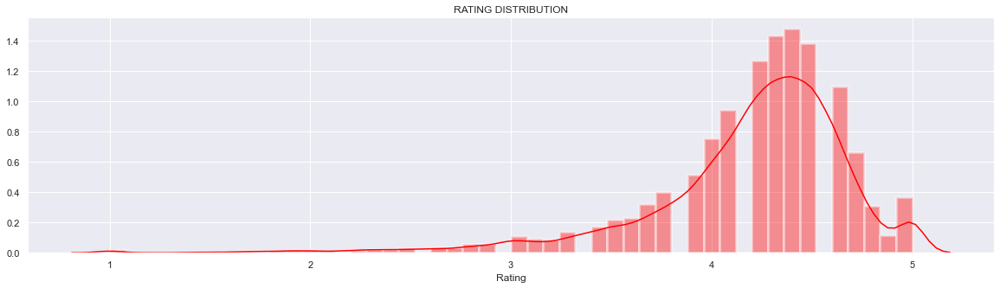

In [225]:
plt.figure(figsize=(20,5))
sns.distplot(Data['Rating'],color='red',hist_kws={"linewidth":3});
plt.title("RATING DISTRIBUTION")
plt.show()

In [193]:
print("Skewness :%f" % Data['Rating'].skew())
print("kurtosis :%f" % Data['Rating'].kurt())


Skewness :-1.849695
kurtosis :5.786924


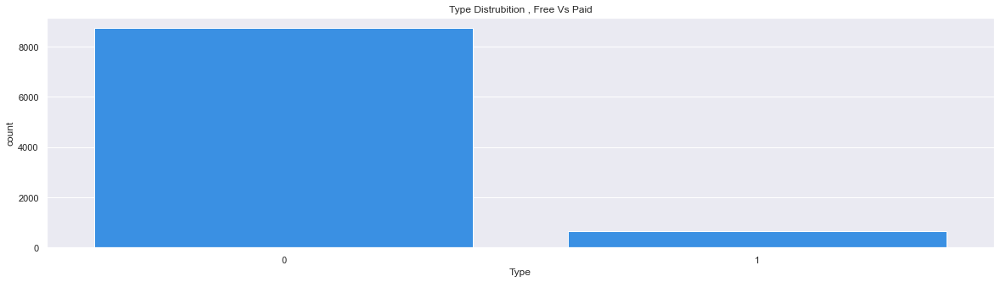

In [226]:
#histogram fro Free vs Paid Apps 
plt.figure(figsize=(20,5))
sns.countplot(Data['Type'],color='dodgerblue' );
plt.title("Type Distrubition , Free Vs Paid")
plt.show()

In [202]:
#It seems Most Of the Apps Published On Play Store Are Free :)


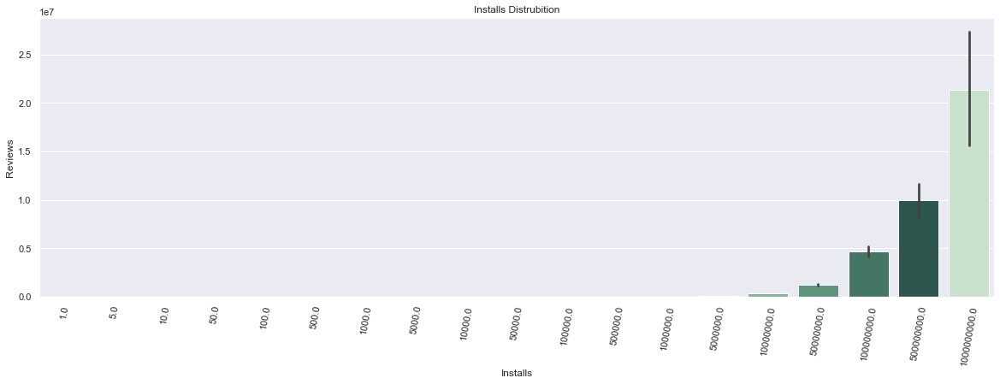

In [227]:
#histogram Which Describs the Counts Of Installed Apps 
plt.figure(figsize=(20,6))
sns.barplot(x= Data['Installs'],y= Data.Reviews,color='b',palette=sns.color_palette("ch:2.5,-.2,dark=.3"));
plt.title("Installs Distrubition")
plt.xticks(rotation=80)
plt.show()

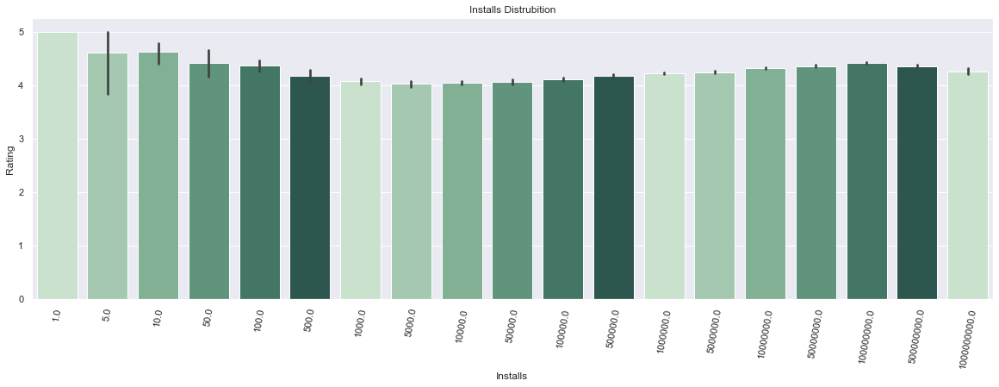

In [228]:
plt.figure(figsize=(20,6))
sns.barplot(x= Data['Installs'],y= Data.Rating,color='b',palette=sns.color_palette("ch:2.5,-.2,dark=.3"));
plt.title("Installs Distrubition")
plt.xticks(rotation=80)
plt.show()

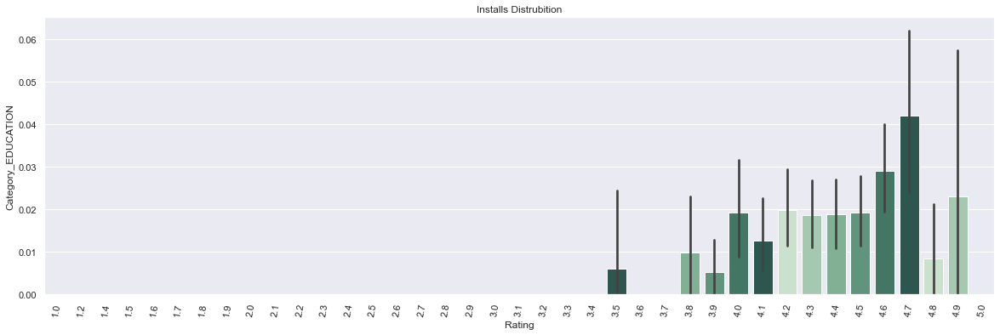

In [229]:
#histogram Which Describs the Counts Of Installed Apps 
plt.figure(figsize=(20,6))
sns.barplot(x= Data['Rating'],y= Data.Category_EDUCATION,color='b',palette=sns.color_palette("ch:2.5,-.2,dark=.3"));
plt.title("Installs Distrubition")
plt.xticks(rotation=80)
plt.show()

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18]),
 <a list of 19 Text major ticklabel objects>)

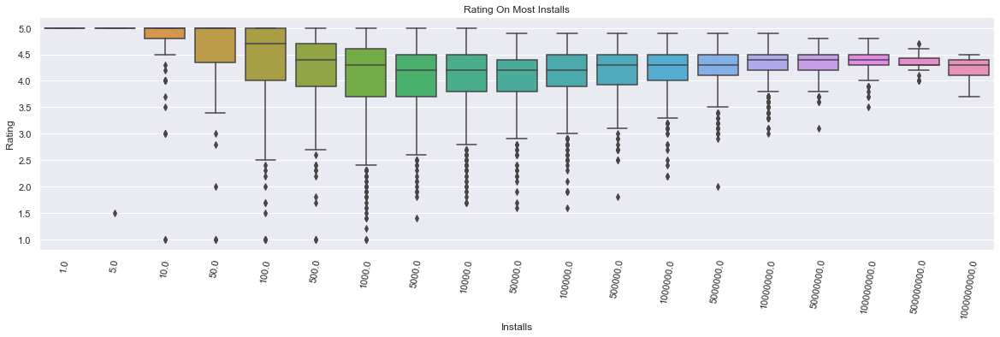

In [230]:
ax = plt.figure(figsize=(20,5))
sns.set()
sns.boxplot(x="Installs", y ="Rating", data=Data)
plt.title("Rating On Most Installs")
plt.xticks(rotation = 80)

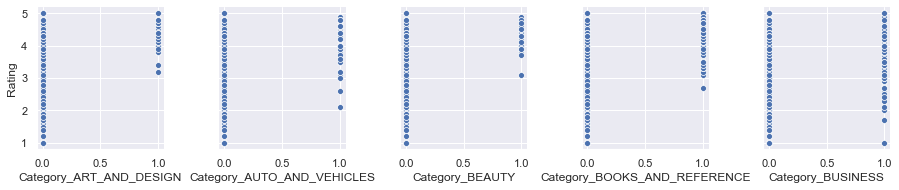

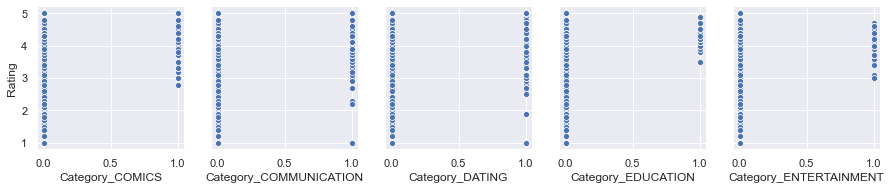

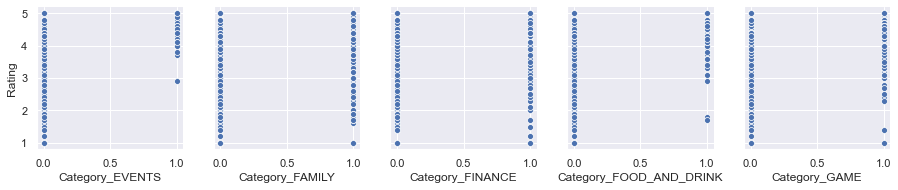

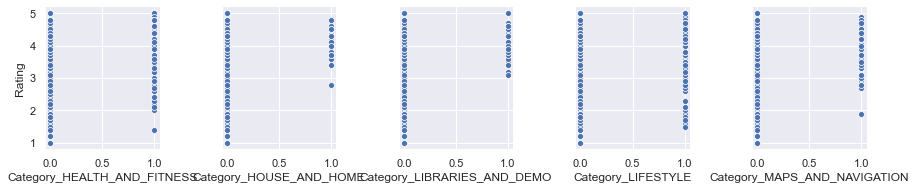

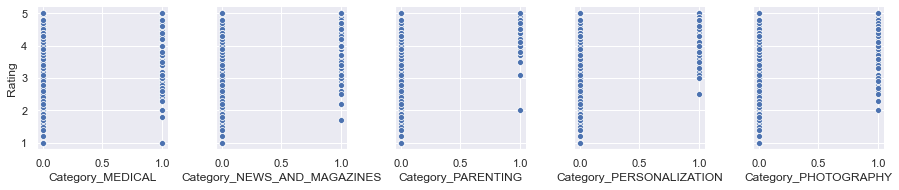

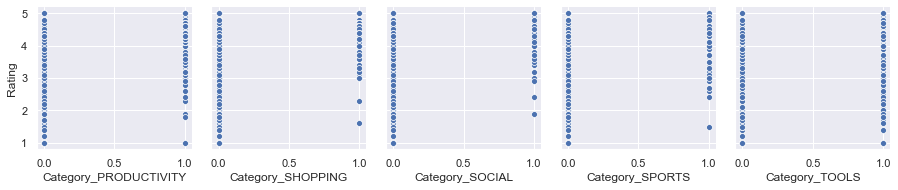

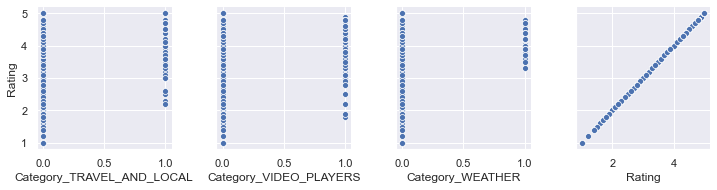

In [233]:
chart_data = Data.loc[:,"Category_ART_AND_DESIGN":"Category_WEATHER"]
chart_data['Rating'] = Data["Rating"]
for i in range(0,len(chart_data.columns),5):
    sns.pairplot(data = chart_data, x_vars=chart_data.columns[i:i+5],y_vars=['Rating'])

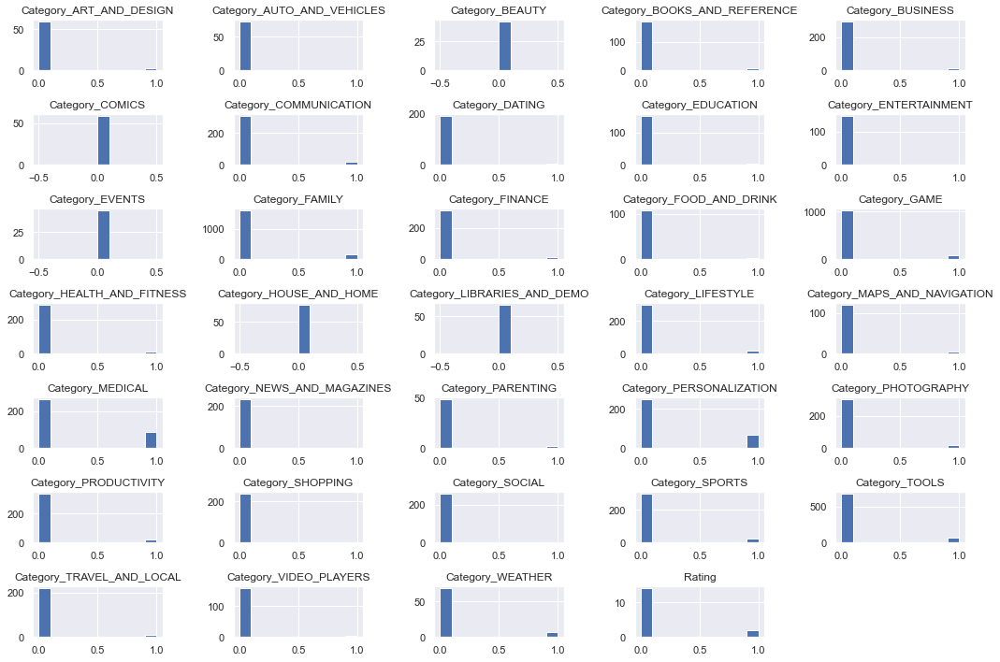

In [249]:
import math
#del chart_data["Rating"]
l = len(chart_data.columns.values)
r = math.ceil(l/5)

chart_data["Type"] = Data["Type"]
j=1
plt.subplots(figsize=(15,10),tight_layout=True)
for i in chart_data.columns.values:
    if i=="Type":
        continue
    d = chart_data[chart_data[i]==1]
    plt.subplot(r, 5, j)
    plt.hist(d["Type"])
    plt.title(i)
    j +=1
    
plt.show()

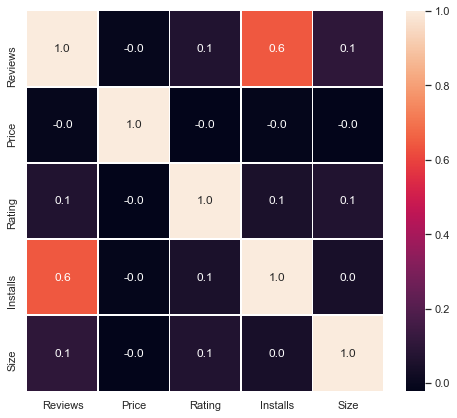

In [250]:
fig,ax = plt.subplots(figsize=(8,7))
ax = sns.heatmap(Data[["Reviews","Price","Rating","Installs","Size"]].corr(), annot=True,linewidths=.5,fmt='.1f')
plt.show()
